In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import VOCSegmentation
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import hiddenlayer as hl
import matplotlib.pyplot as plt
torch.manual_seed(0)

def show_tensor_images(image_tensor, num_images=25, size=(1, 64, 64)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_shifted = image_tensor
    image_unflat = image_shifted.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()


import glob
import random
import os
from torch.utils.data import Dataset
from PIL import Image

# Architecture

In [2]:
class ResidualBlock(nn.Module):
    '''
    ResidualBlock Class:
    Performs two convolutions and an instance normalization, the input is added
    to this output to form the residual block output.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv2 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
        self.instancenorm = nn.InstanceNorm2d(input_channels)
        self.activation = nn.ReLU()

    def forward(self, x):
        '''
        Function for completing a forward pass of ResidualBlock: 
        Given an image tensor, completes a residual block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        original_x = x.clone()
        x = self.conv1(x)
        x = self.instancenorm(x)
        x = self.activation(x)
        x = self.conv2(x)
        x = self.instancenorm(x)
        return original_x + x

In [3]:
class ContractingBlock(nn.Module):
    '''
    ContractingBlock Class
    Performs a convolution followed by a max pool operation and an optional instance norm.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels, use_bn=True, kernel_size=3, activation='relu'):
        super(ContractingBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels * 2, kernel_size=kernel_size, padding=1, stride=2, padding_mode='reflect')
        self.activation = nn.ReLU() if activation == 'relu' else nn.LeakyReLU(0.2)
        if use_bn:
            self.instancenorm = nn.InstanceNorm2d(input_channels * 2)
        self.use_bn = use_bn

    def forward(self, x):
        '''
        Function for completing a forward pass of ContractingBlock: 
        Given an image tensor, completes a contracting block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.conv1(x)
        if self.use_bn:
            x = self.instancenorm(x)
        x = self.activation(x)
        return x

class ExpandingBlock(nn.Module):
    '''
    ExpandingBlock Class:
    Performs a convolutional transpose operation in order to upsample, 
        with an optional instance norm
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels, use_bn=True):
        super(ExpandingBlock, self).__init__()
        self.conv1 = nn.ConvTranspose2d(input_channels, input_channels // 2, kernel_size=3, stride=2, padding=1, output_padding=1)
        if use_bn:
            self.instancenorm = nn.InstanceNorm2d(input_channels // 2)
        self.use_bn = use_bn
        self.activation = nn.ReLU()

    def forward(self, x):
        '''
        Function for completing a forward pass of ExpandingBlock: 
        Given an image tensor, completes an expanding block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
            skip_con_x: the image tensor from the contracting path (from the opposing block of x)
                    for the skip connection
        '''
        x = self.conv1(x)
        if self.use_bn:
            x = self.instancenorm(x)
        x = self.activation(x)
        return x

class FeatureMapBlock(nn.Module):
    '''
    FeatureMapBlock Class
    The final layer of a Generator - 
    maps each the output to the desired number of output channels
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    def __init__(self, input_channels, output_channels):
        super(FeatureMapBlock, self).__init__()
        self.conv = nn.Conv2d(input_channels, output_channels, kernel_size=7, padding=3, padding_mode='reflect')

    def forward(self, x):
        '''
        Function for completing a forward pass of FeatureMapBlock: 
        Given an image tensor, returns it mapped to the desired number of channels.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.conv(x)
        return x

In [4]:
class Generator(nn.Module):
    '''
    Generator Class
    A series of 2 contracting blocks, 9 residual blocks, and 2 expanding blocks to 
    transform an input image into an image from the other class, with an upfeature
    layer at the start and a downfeature layer at the end.
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    def __init__(self, input_channels, output_channels, hidden_channels=64):
        super(Generator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels)
        self.contract2 = ContractingBlock(hidden_channels * 2)
        res_mult = 4
        self.res0 = ResidualBlock(hidden_channels * res_mult)
        self.res1 = ResidualBlock(hidden_channels * res_mult)
        self.res2 = ResidualBlock(hidden_channels * res_mult)
        self.res3 = ResidualBlock(hidden_channels * res_mult)
        self.res4 = ResidualBlock(hidden_channels * res_mult)
        self.res5 = ResidualBlock(hidden_channels * res_mult)
        self.res6 = ResidualBlock(hidden_channels * res_mult)
        self.res7 = ResidualBlock(hidden_channels * res_mult)
        self.res8 = ResidualBlock(hidden_channels * res_mult)
        self.expand2 = ExpandingBlock(hidden_channels * 4)
        self.expand3 = ExpandingBlock(hidden_channels * 2)
        self.downfeature = FeatureMapBlock(hidden_channels, output_channels)
        self.tanh = torch.nn.Tanh()

    def forward(self, x):
        '''
        Function for completing a forward pass of Generator: 
        Given an image tensor, passes it through the U-Net with residual blocks
        and returns the output.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.res0(x2)
        x4 = self.res1(x3)
        x5 = self.res2(x4)
        x6 = self.res3(x5)
        x7 = self.res4(x6)
        x8 = self.res5(x7)
        x9 = self.res6(x8)
        x10 = self.res7(x9)
        x11 = self.res8(x10)
        x12 = self.expand2(x11)
        x13 = self.expand3(x12)
        xn = self.downfeature(x13)
        return self.tanh(xn)

In [5]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Structured like the contracting path of the U-Net, the discriminator will
    output a matrix of values classifying corresponding portions of the image as real or fake. 
    Parameters:
        input_channels: the number of image input channels
        hidden_channels: the initial number of discriminator convolutional filters
    '''
    def __init__(self, input_channels, hidden_channels=64):
        super(Discriminator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels, use_bn=False, kernel_size=4, activation='lrelu')
        self.contract2 = ContractingBlock(hidden_channels * 2, kernel_size=4, activation='lrelu')
        self.contract3 = ContractingBlock(hidden_channels * 4, kernel_size=4, activation='lrelu')
        self.final = nn.Conv2d(hidden_channels * 8, 1, kernel_size=1)

    def forward(self, x):
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.contract3(x2)
        xn = self.final(x3)
        return xn

# Training Setup

In [6]:
import torch.nn.functional as F

adv_criterion = nn.MSELoss() 
recon_criterion = nn.L1Loss() 

n_epochs = 25
dim_A = 3
dim_B = 3
display_step = 200
batch_size = 16
lr = 0.0002
load_shape = (64,64)
target_shape = 64
device = 'cuda'

In [7]:
print(os.getcwd())
os.chdir('..')
os.getcwd()

/home/anhnguyen/Documents/GAN/src


'/home/anhnguyen/Documents/GAN'

In [8]:
class ImageDataset(Dataset):
    def __init__(self, train_path, target_path, train_transform=None, target_transform = None):
        self.train_transform = train_transform
        self.target_transform = target_transform
        
        self.files_A = glob.glob(f'{train_path}/*/*')
        self.files_B = glob.glob(f'{target_path}/*/*')
        
        self.new_perm()
        
    def new_perm(self):
        if(len(self.files_A) <= len(self.files_B)):
            self.randperm = torch.randperm(len(self.files_B))[:len(self.files_A)]
        else:
            self.randperm = torch.randperm(len(self.files_A))[:len(self.files_B)]

    def __getitem__(self, index):
        item_B = self.target_transform(Image.open(self.files_B[index % len(self.files_B)]))

        item_A = self.train_transform(Image.open(self.files_A[self.randperm[index]]))
        
        # Old versions of PyTorch didn't support normalization for different-channeled images
        return (item_A, item_B)

    def __len__(self):
        return min(len(self.files_A), len(self.files_B))

In [9]:
waifu_path = 'animeFaces64'
laifu_path = 'humanFaces64'

anime_transform = transforms.Compose([
    transforms.Resize(load_shape),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
])

human_transform = transforms.Compose([
    transforms.Resize(load_shape),
    transforms.ColorJitter(
        brightness = [0.85, 1.15],
    ),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
])

import torchvision
dataset = ImageDataset(
    train_path = laifu_path,
    target_path = waifu_path,
    train_transform = human_transform,
    target_transform = anime_transform
)

# Create model and get loss

In [10]:
gen_AB = Generator(dim_A, dim_B).to(device)
gen_BA = Generator(dim_B, dim_A).to(device)
gen_opt = torch.optim.Adam(list(gen_AB.parameters()) + list(gen_BA.parameters()), lr=lr, betas=(0.5, 0.999))
disc_A = Discriminator(dim_A).to(device)
disc_A_opt = torch.optim.Adam(disc_A.parameters(), lr=lr, betas=(0.5, 0.999))
disc_B = Discriminator(dim_B).to(device)
disc_B_opt = torch.optim.Adam(disc_B.parameters(), lr=lr, betas=(0.5, 0.999))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

# Feel free to change pretrained to False if you're training the model from scratch
pretrained = False
if pretrained:
    pre_dict = torch.load('cycleGAN_100000.pth')
    gen_AB.load_state_dict(pre_dict['gen_AB'])
    gen_BA.load_state_dict(pre_dict['gen_BA'])
    gen_opt.load_state_dict(pre_dict['gen_opt'])
    disc_A.load_state_dict(pre_dict['disc_A'])
    disc_A_opt.load_state_dict(pre_dict['disc_A_opt'])
    disc_B.load_state_dict(pre_dict['disc_B'])
    disc_B_opt.load_state_dict(pre_dict['disc_B_opt'])
else:
    gen_AB = gen_AB.apply(weights_init)
    gen_BA = gen_BA.apply(weights_init)
    disc_A = disc_A.apply(weights_init)
    disc_B = disc_B.apply(weights_init)

In [11]:
#Discriminator loss
def get_disc_loss(real_X, fake_X, disc_X, adv_criterion):
    '''
    Return the loss of the discriminator given inputs.
    Parameters:
        real_X: the real images from pile X
        fake_X: the generated images of class X
        disc_X: the discriminator for class X; takes images and returns real/fake class X
            prediction matrices
        adv_criterion: the adversarial loss function; takes the discriminator 
            predictions and the target labels and returns a adversarial 
            loss (which you aim to minimize)
    '''
    #### START CODE HERE ####    
    disc_fake_X_hat = disc_X(fake_X.detach()) # Detach generator
    disc_fake_X_loss = adv_criterion(disc_fake_X_hat, torch.zeros_like(disc_fake_X_hat))
    disc_real_X_hat = disc_X(real_X)
    disc_real_X_loss = adv_criterion(disc_real_X_hat, torch.ones_like(disc_real_X_hat))
    disc_loss = (disc_fake_X_loss + disc_real_X_loss) / 2
    #### END CODE HERE ####
    return disc_loss

#Generator loss
def get_gen_adversarial_loss(real_X, disc_Y, gen_XY, adv_criterion):
    '''
    Return the adversarial loss of the generator given inputs
    (and the generated images for testing purposes).
    Parameters:
        real_X: the real images from pile X
        disc_Y: the discriminator for class Y; takes images and returns real/fake class Y
            prediction matrices
        gen_XY: the generator for class X to Y; takes images and returns the images 
            transformed to class Y
        adv_criterion: the adversarial loss function; takes the discriminator 
                  predictions and the target labels and returns a adversarial 
                  loss (which you aim to minimize)
    '''
    #### START CODE HERE ####
    fake_Y = gen_XY(real_X)
    disc_fake_Y_hat = disc_Y(fake_Y)
    adversarial_loss = adv_criterion(disc_fake_Y_hat, torch.ones_like(disc_fake_Y_hat))
    #### END CODE HERE ####
    return adversarial_loss, fake_Y

#Identity loss
def get_identity_loss(real_X, gen_YX, identity_criterion):
    '''
    Return the identity loss of the generator given inputs
    (and the generated images for testing purposes).
    Parameters:
        real_X: the real images from pile X
        gen_YX: the generator for class Y to X; takes images and returns the images 
            transformed to class X
        identity_criterion: the identity loss function; takes the real images from X and
                        those images put through a Y->X generator and returns the identity 
                        loss (which you aim to minimize)
    '''
    #### START CODE HERE ####
    identity_X = gen_YX(real_X)
    identity_loss = identity_criterion(identity_X, real_X)
    #### END CODE HERE ####
    return identity_loss, identity_X

#Cycle consistency loss
def get_cycle_consistency_loss(real_X, fake_Y, gen_YX, cycle_criterion):
    '''
    Return the cycle consistency loss of the generator given inputs
    (and the generated images for testing purposes).
    Parameters:
        real_X: the real images from pile X
        fake_Y: the generated images of class Y
        gen_YX: the generator for class Y to X; takes images and returns the images 
            transformed to class X
        cycle_criterion: the cycle consistency loss function; takes the real images from X and
                        those images put through a X->Y generator and then Y->X generator
                        and returns the cycle consistency loss (which you aim to minimize)
    '''
    #### START CODE HERE ####
    cycle_X = gen_YX(fake_Y)
    cycle_loss = cycle_criterion(cycle_X, real_X)
    #### END CODE HERE ####
    return cycle_loss, cycle_X

In [12]:
def get_gen_loss(real_A, real_B, gen_AB, gen_BA, disc_A, disc_B, adv_criterion, identity_criterion, cycle_criterion, lambda_identity=0.1, lambda_cycle=10):
    '''
    Return the loss of the generator given inputs.
    Parameters:
        real_A: the real images from pile A
        real_B: the real images from pile B
        gen_AB: the generator for class A to B; takes images and returns the images 
            transformed to class B
        gen_BA: the generator for class B to A; takes images and returns the images 
            transformed to class A
        disc_A: the discriminator for class A; takes images and returns real/fake class A
            prediction matrices
        disc_B: the discriminator for class B; takes images and returns real/fake class B
            prediction matrices
        adv_criterion: the adversarial loss function; takes the discriminator 
            predictions and the true labels and returns a adversarial 
            loss (which you aim to minimize)
        identity_criterion: the reconstruction loss function used for identity loss
            and cycle consistency loss; takes two sets of images and returns
            their pixel differences (which you aim to minimize)
        cycle_criterion: the cycle consistency loss function; takes the real images from X and
            those images put through a X->Y generator and then Y->X generator
            and returns the cycle consistency loss (which you aim to minimize).
            Note that in practice, cycle_criterion == identity_criterion == L1 loss
        lambda_identity: the weight of the identity loss
        lambda_cycle: the weight of the cycle-consistency loss
    '''
    # Hint 1: Make sure you include both directions - you can think of the generators as collaborating
    # Hint 2: Don't forget to use the lambdas for the identity loss and cycle loss!
    #### START CODE HERE ####
    # Adversarial Loss -- get_gen_adversarial_loss(real_X, disc_Y, gen_XY, adv_criterion)
    adv_loss_BA, fake_A = get_gen_adversarial_loss(real_B, disc_A, gen_BA, adv_criterion)
    adv_loss_AB, fake_B = get_gen_adversarial_loss(real_A, disc_B, gen_AB, adv_criterion)
    gen_adversarial_loss = adv_loss_BA + adv_loss_AB

    # Identity Loss -- get_identity_loss(real_X, gen_YX, identity_criterion)
    identity_loss_A, identity_A = get_identity_loss(real_A, gen_BA, identity_criterion)
    identity_loss_B, identity_B = get_identity_loss(real_B, gen_AB, identity_criterion)
    gen_identity_loss = identity_loss_A + identity_loss_B

    # Cycle-consistency Loss -- get_cycle_consistency_loss(real_X, fake_Y, gen_YX, cycle_criterion)
    cycle_loss_BA, cycle_A = get_cycle_consistency_loss(real_A, fake_B, gen_BA, cycle_criterion)
    cycle_loss_AB, cycle_B = get_cycle_consistency_loss(real_B, fake_A, gen_AB, cycle_criterion)
    gen_cycle_loss = cycle_loss_BA + cycle_loss_AB

    # Total loss
    gen_loss = lambda_identity * gen_identity_loss + lambda_cycle * gen_cycle_loss + gen_adversarial_loss
    #### END CODE HERE ####
    return gen_loss, fake_A, fake_B

In [13]:
from skimage import color
import numpy as np
plt.rcParams["figure.figsize"] = (10, 10)

def train(save_model=True, model_save_dir = 'laifu2waifu_CycleGAN_weights_64'):
    generator_loss = []
    discriminator_loss = []
    mean_generator_loss = 0
    mean_discriminator_loss = 0
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers = 2)

    for epoch in range(n_epochs):
        # Dataloader returns the batches
        # for image, _ in tqdm(dataloader):
        for real_A, real_B in tqdm(dataloader):
            # image_width = image.shape[3]
#             real_A = nn.functional.interpolate(real_A, size=target_shape)
#             real_B = nn.functional.interpolate(real_B, size=target_shape)
            real_A = real_A.to(device)
            real_B = real_B.to(device)

            ### Update discriminator A ###
            disc_A_opt.zero_grad() # Zero out the gradient before backpropagation
            with torch.no_grad():
                fake_A = gen_BA(real_B)
            disc_A_loss = get_disc_loss(real_A, fake_A, disc_A, adv_criterion)
            disc_A_loss.backward(retain_graph=True) # Update gradients
            disc_A_opt.step() # Update optimizer

            ### Update discriminator B ###
            disc_B_opt.zero_grad() # Zero out the gradient before backpropagation
            with torch.no_grad():
                fake_B = gen_AB(real_A)
            disc_B_loss = get_disc_loss(real_B, fake_B, disc_B, adv_criterion)
            disc_B_loss.backward(retain_graph=True) # Update gradients
            disc_B_opt.step() # Update optimizer

            ### Update generator ###
            gen_opt.zero_grad()
            gen_loss, fake_A, fake_B = get_gen_loss(
                real_A, real_B, gen_AB, gen_BA, disc_A, disc_B, adv_criterion, recon_criterion, recon_criterion
            )
            gen_loss.backward() # Update gradients
            gen_opt.step() # Update optimizer

            # Keep track of the average discriminator loss
            mean_discriminator_loss += disc_A_loss.item() / batch_size
            # Keep track of the average generator loss
            mean_generator_loss += gen_loss.item() / batch_size
        
        generator_loss = []
        discriminator_loss = []
        print(f"Epoch {epoch}: Generator (U-Net) loss: {mean_generator_loss}, Discriminator loss: {mean_discriminator_loss}")

        mean_discriminator_loss = 0
        # Keep track of the average generator loss
        mean_generator_loss = 0
            
        ### Visualization code ###
        show_tensor_images(real_A, size=(dim_A, target_shape, target_shape))
        show_tensor_images(real_B, size=(dim_A, target_shape, target_shape))
        show_tensor_images(fake_A, size=(dim_B, target_shape, target_shape))
        show_tensor_images(fake_B, size=(dim_B, target_shape, target_shape))

        # You can change save_model to True if you'd like to save the model
        if save_model:
            if not os.path.exists(model_save_dir):
                os.mkdir(model_save_dir)
            
            torch.save(gen_AB, f"{model_save_dir}/cycleGAN_genAB_{epoch}.pth")
            torch.save(gen_BA, f"{model_save_dir}/cycleGAN_genBA_{epoch}.pth")
            torch.save(gen_opt,f"{model_save_dir}/cycleGAN_genopt_{epoch}.pth")
            torch.save(disc_A, f"{model_save_dir}/cycleGAN_discA_{epoch}.pth")
            torch.save(disc_A_opt, f"{model_save_dir}/cycleGAN_discAopt_{epoch}.pth")
            torch.save(disc_B, f"{model_save_dir}/cycleGAN_discB_{epoch}.pth")
            torch.save(disc_B_opt, f"{model_save_dir}/cycleGAN_discBopt_{epoch}.pth")
            
            torch.save({
                'gen_AB': gen_AB.state_dict(),
                'gen_BA': gen_BA.state_dict(),
                'gen_opt': gen_opt.state_dict(),
                'disc_A': disc_A.state_dict(),
                'disc_A_opt': disc_A_opt.state_dict(),
                'disc_B': disc_B.state_dict(),
                'disc_B_opt': disc_B_opt.state_dict()
            }, f"{model_save_dir}/cycleGAN_{epoch}.pth")
    return generator_loss, discriminator_loss

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 0: Generator (U-Net) loss: 617.8925414830446, Discriminator loss: 56.060593019239604


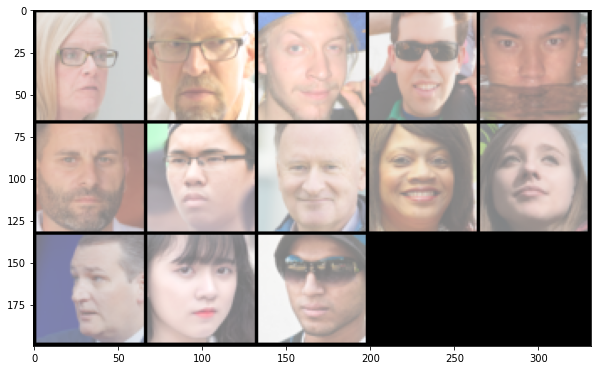

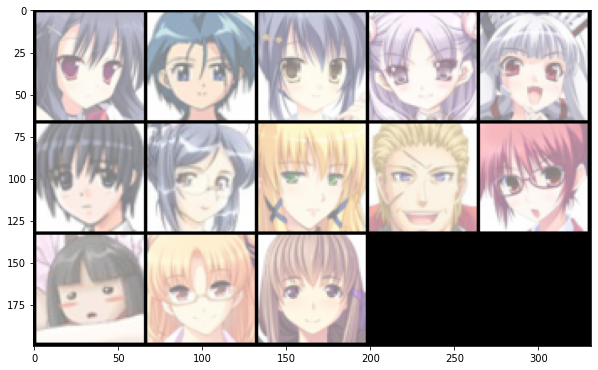

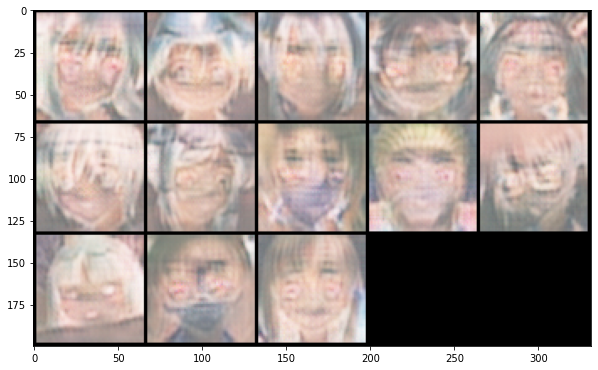

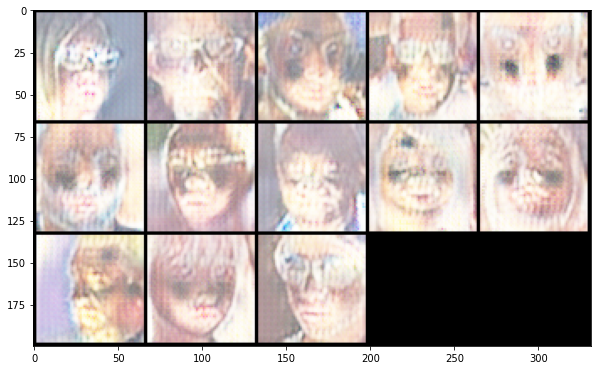

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 1: Generator (U-Net) loss: 576.8443451151252, Discriminator loss: 50.208945953520015


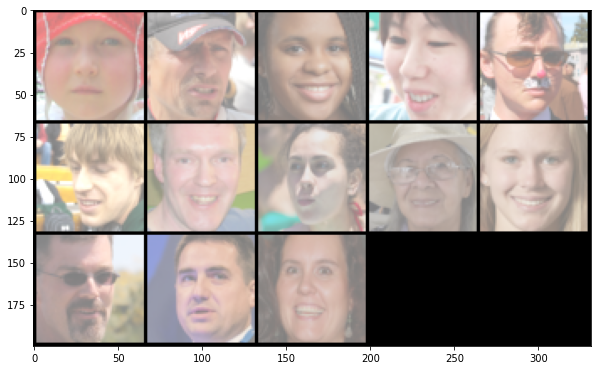

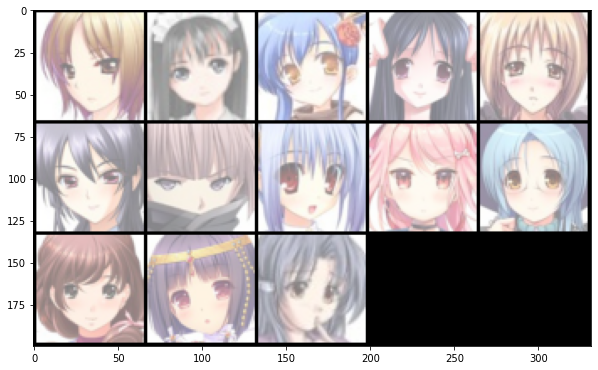

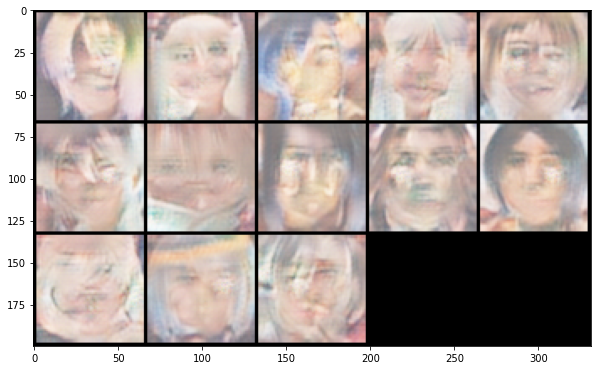

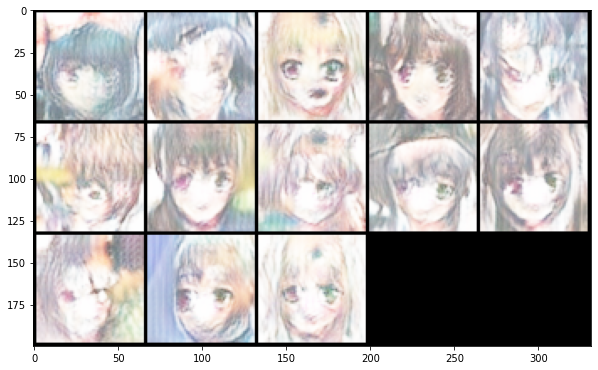

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 2: Generator (U-Net) loss: 481.50369039177895, Discriminator loss: 57.52579208370298


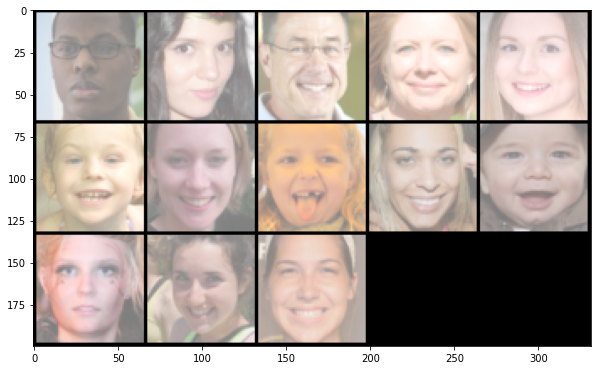

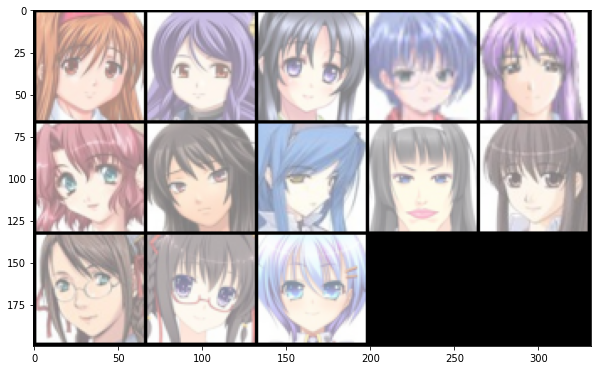

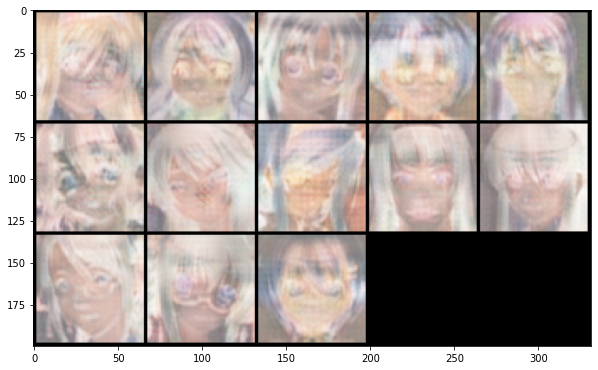

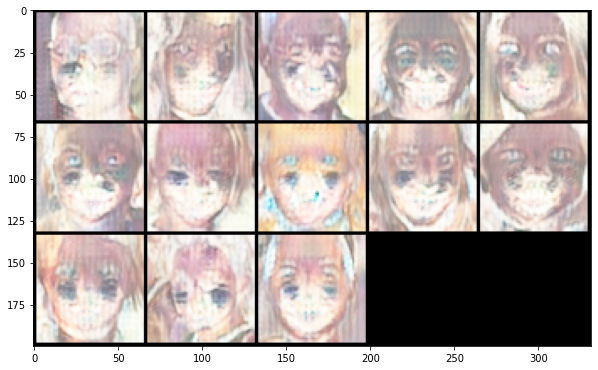

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 3: Generator (U-Net) loss: 533.5880937352777, Discriminator loss: 50.56925847195089


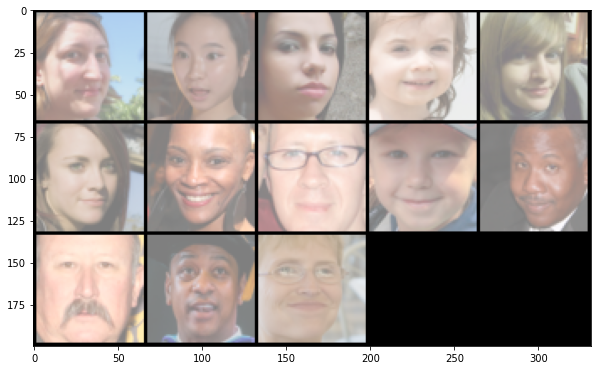

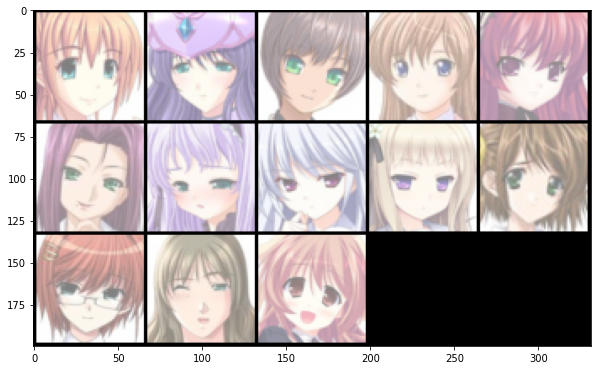

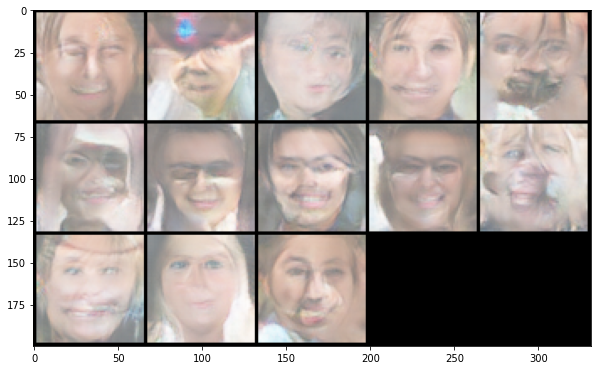

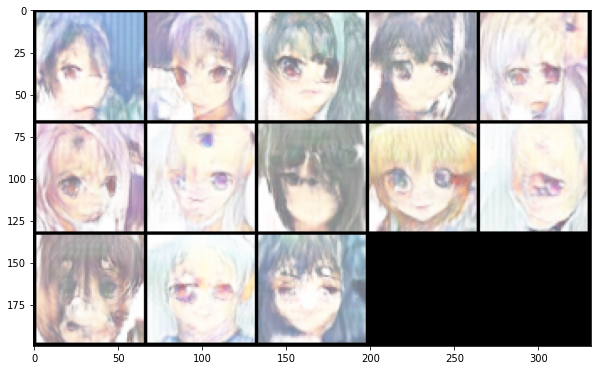

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 4: Generator (U-Net) loss: 456.0513456761837, Discriminator loss: 62.104893676936626


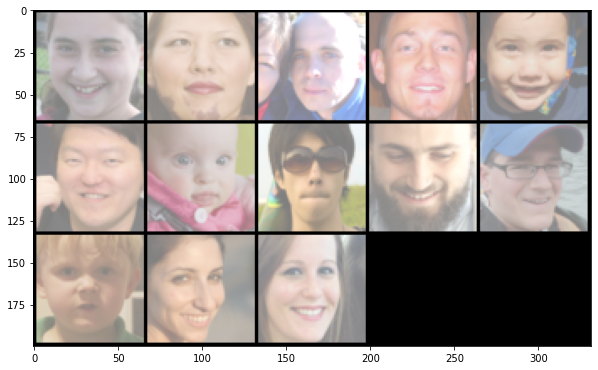

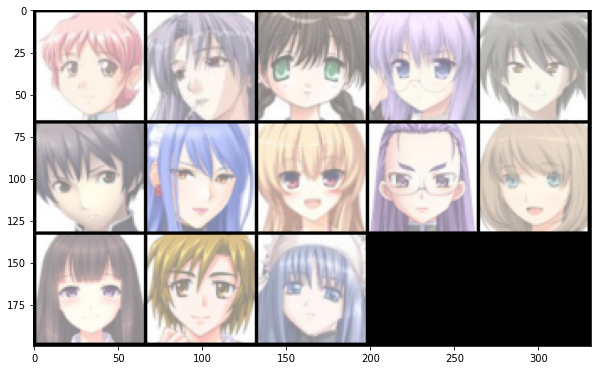

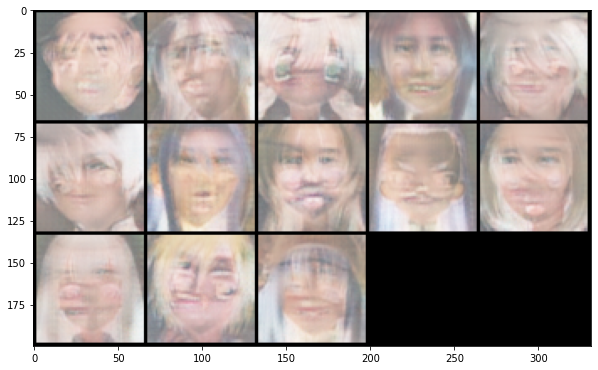

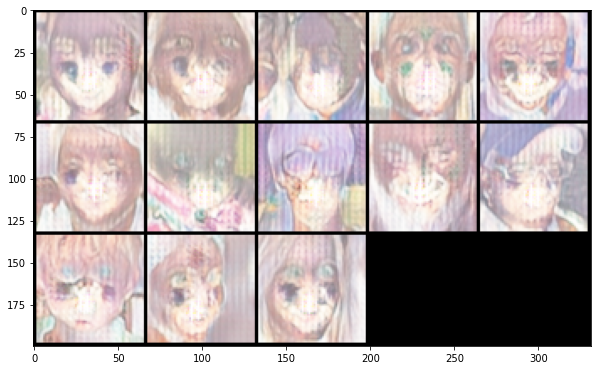

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 5: Generator (U-Net) loss: 413.3543824031949, Discriminator loss: 60.71640095021576


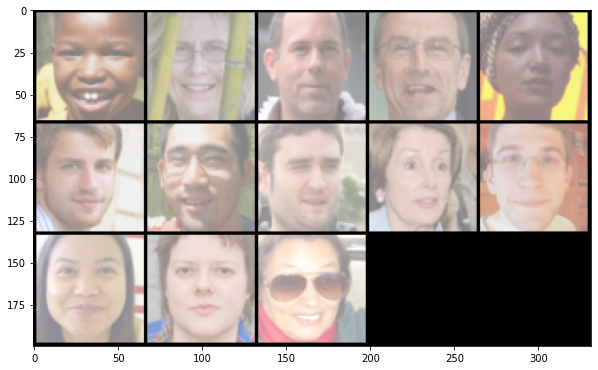

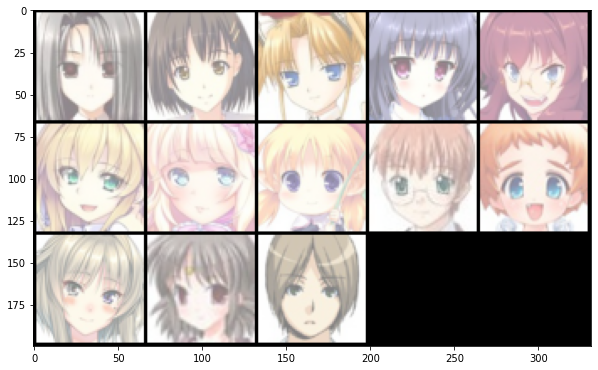

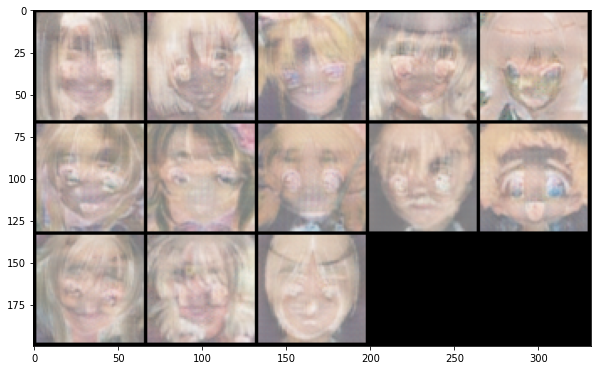

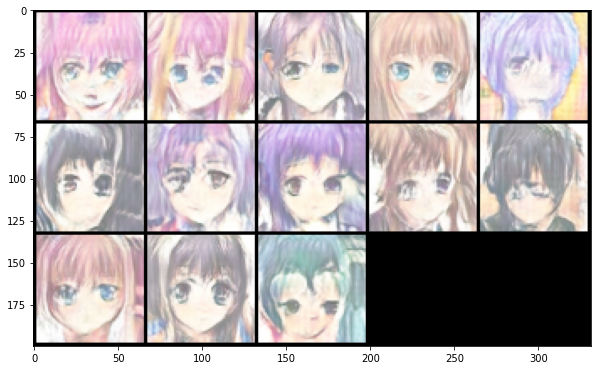

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 6: Generator (U-Net) loss: 423.8155914247036, Discriminator loss: 58.908948723226786


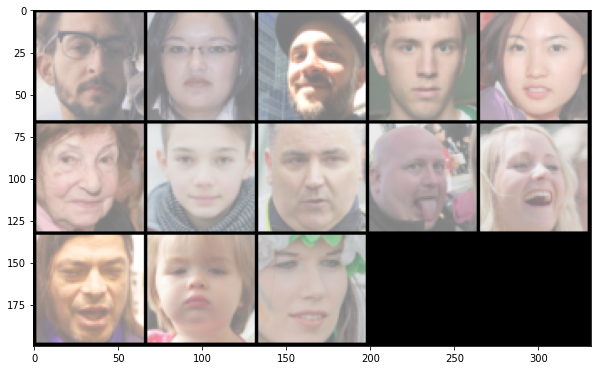

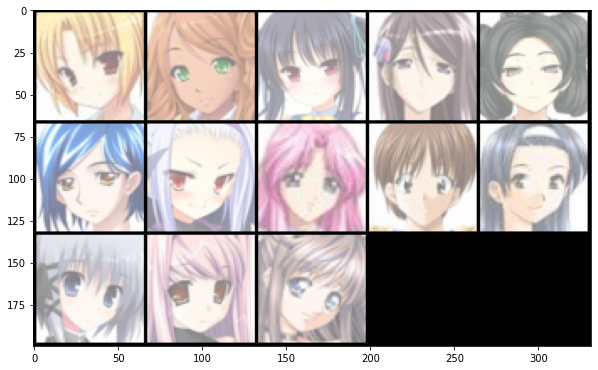

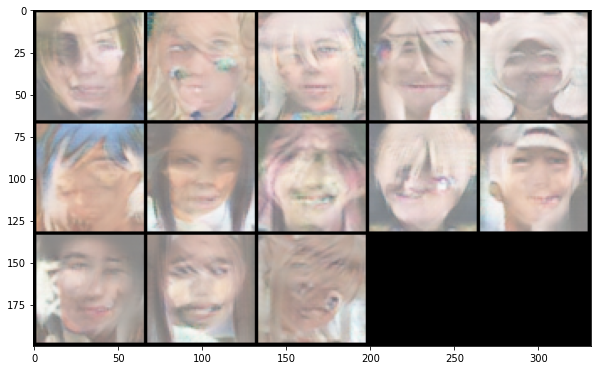

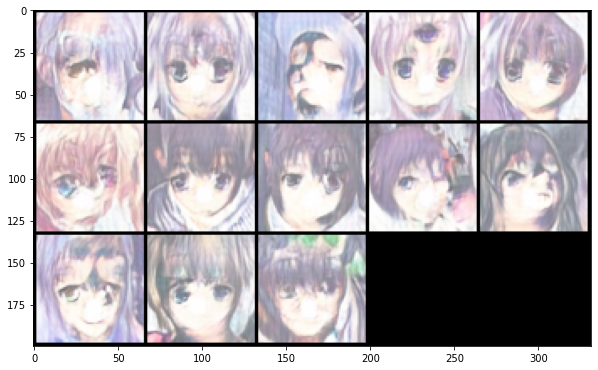

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 7: Generator (U-Net) loss: 485.16929034143686, Discriminator loss: 54.00545578636229


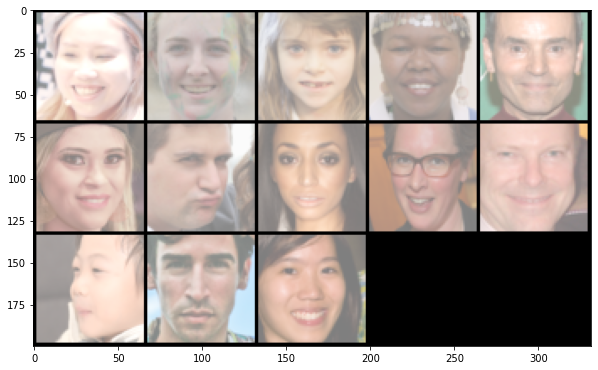

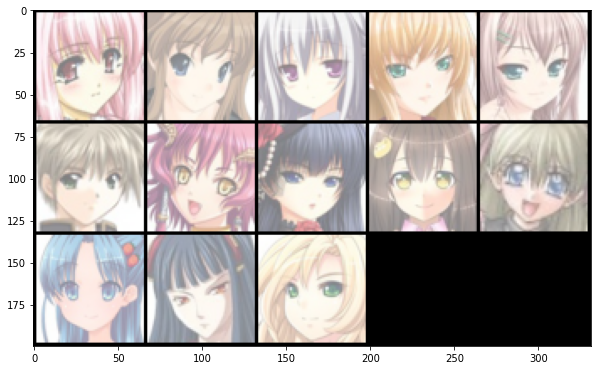

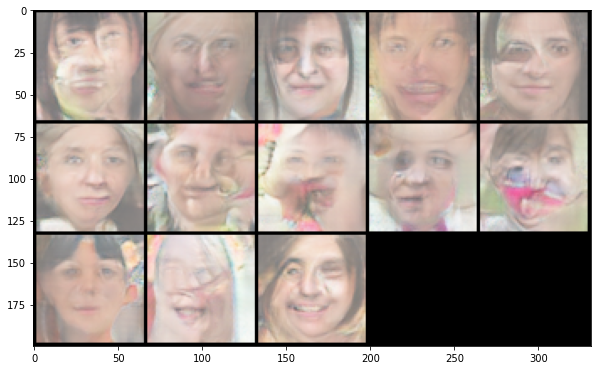

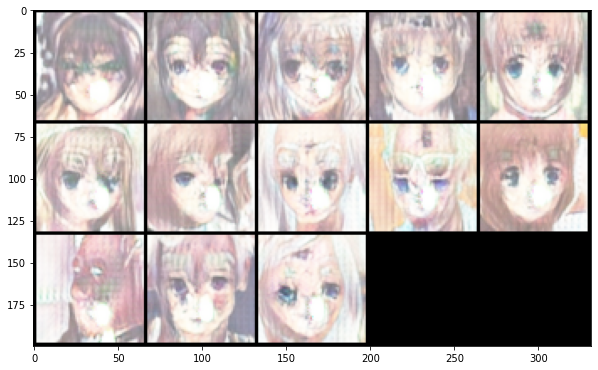

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 8: Generator (U-Net) loss: 427.4940914362669, Discriminator loss: 62.17853844165802


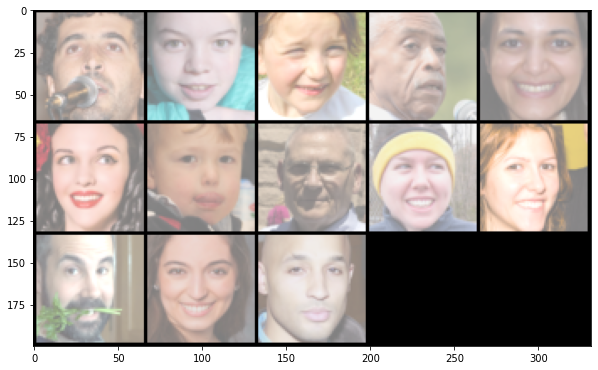

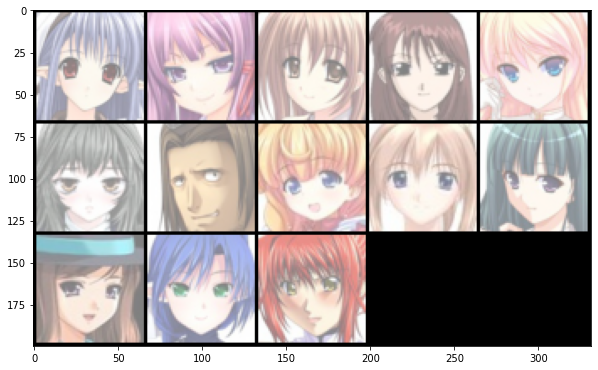

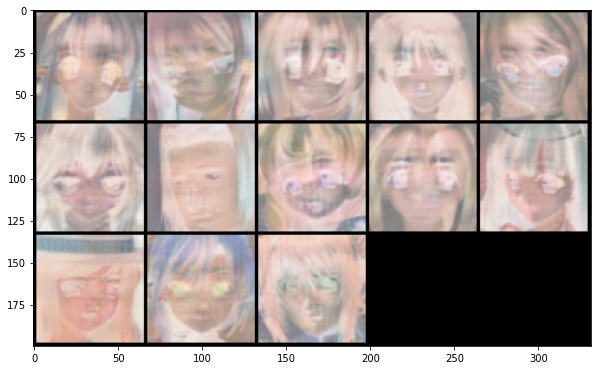

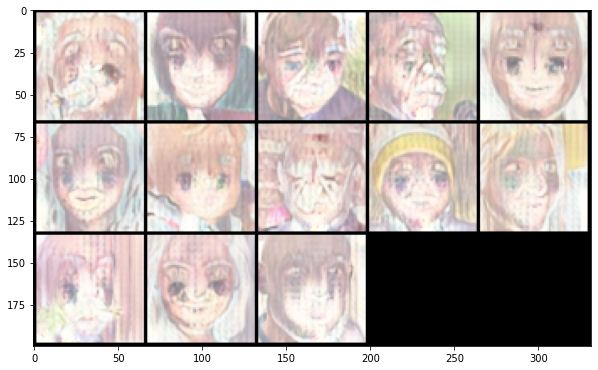

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 9: Generator (U-Net) loss: 349.38507425785065, Discriminator loss: 61.517422950826585


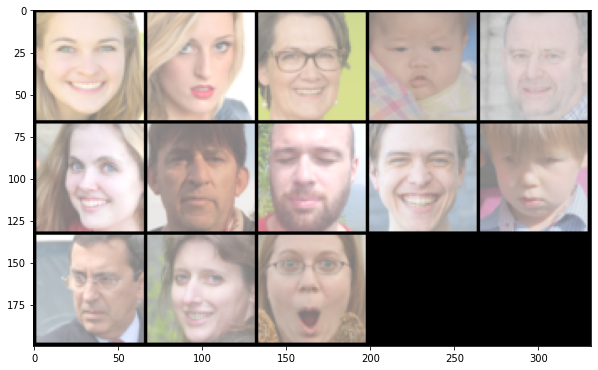

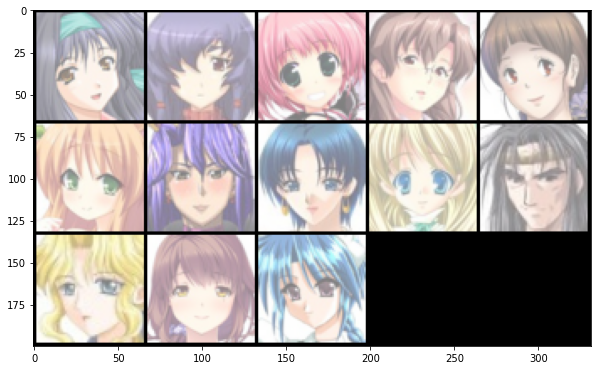

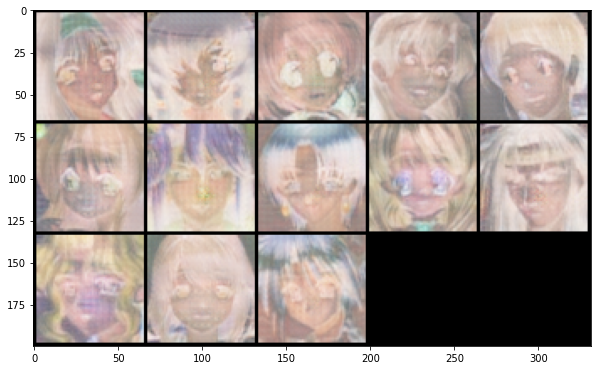

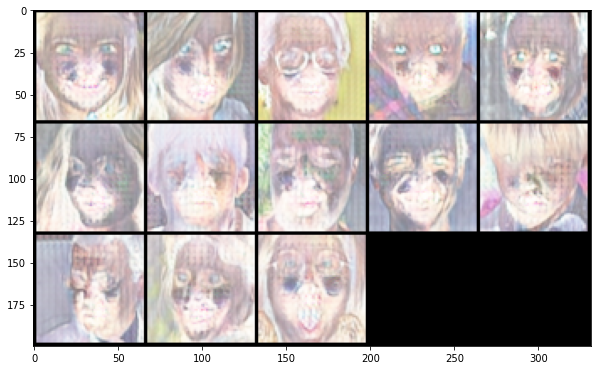

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 10: Generator (U-Net) loss: 395.11055348068476, Discriminator loss: 54.246986045502126


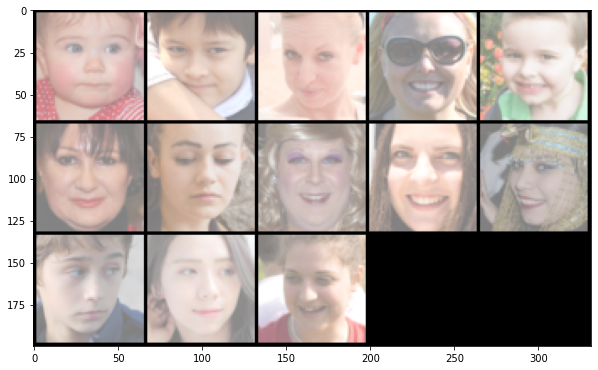

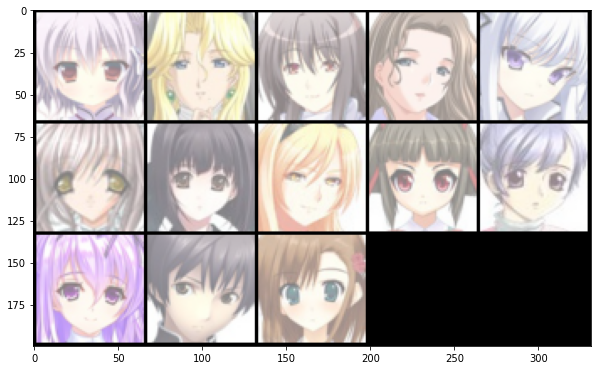

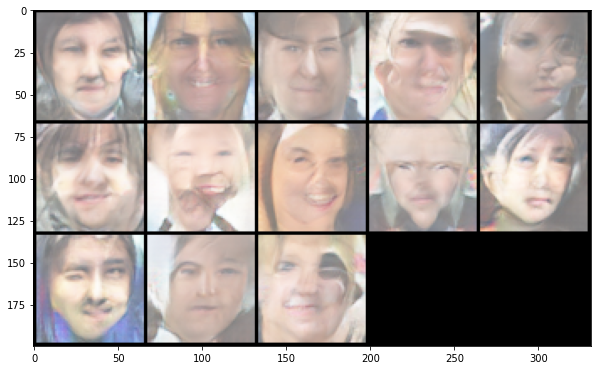

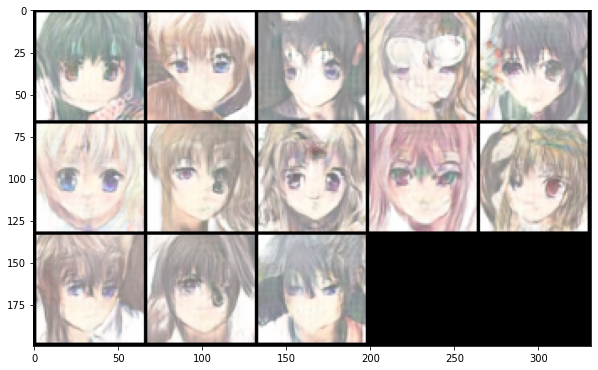

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 11: Generator (U-Net) loss: 425.8384158164263, Discriminator loss: 51.469510620459914


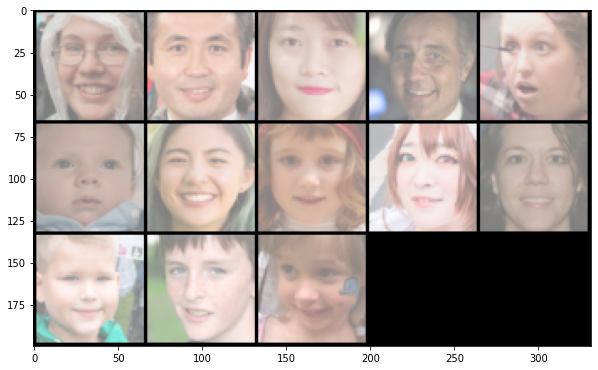

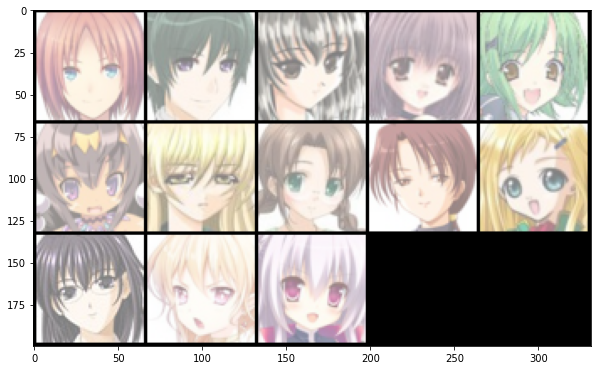

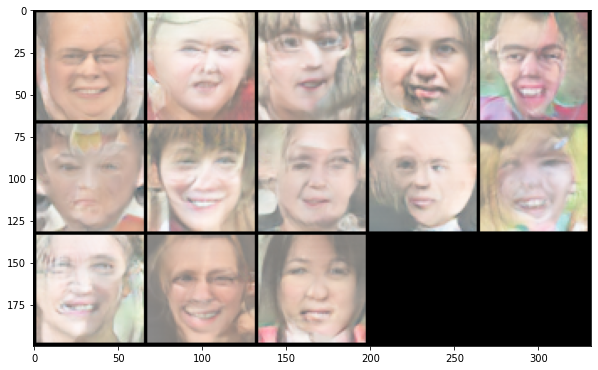

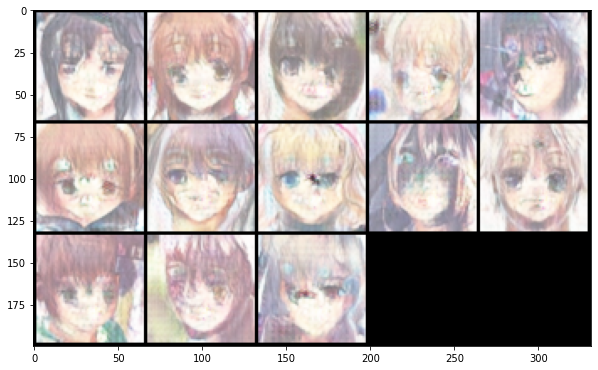

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 12: Generator (U-Net) loss: 450.53851718455553, Discriminator loss: 68.33612326905131


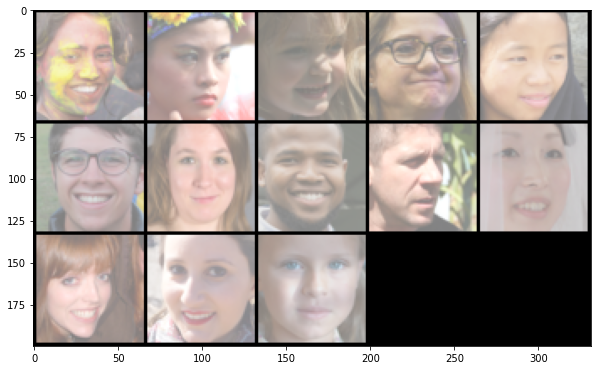

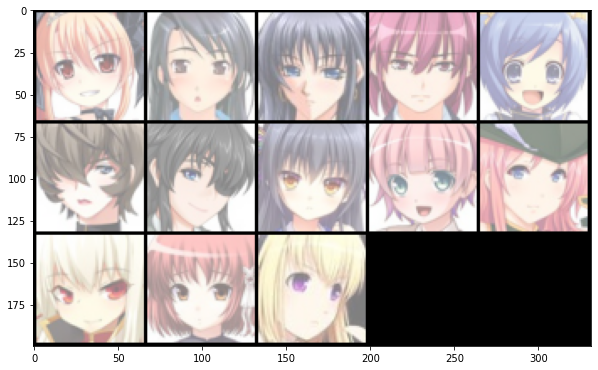

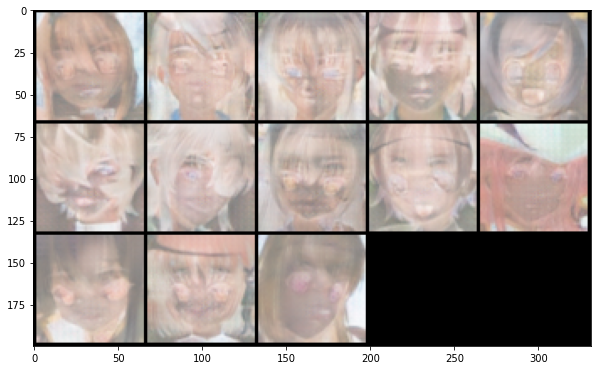

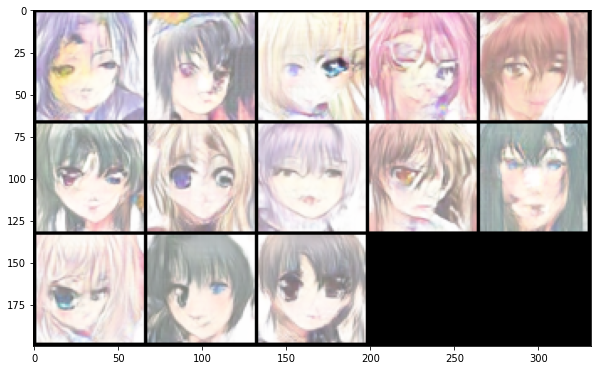

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 13: Generator (U-Net) loss: 446.7098245024681, Discriminator loss: 61.373372899368405


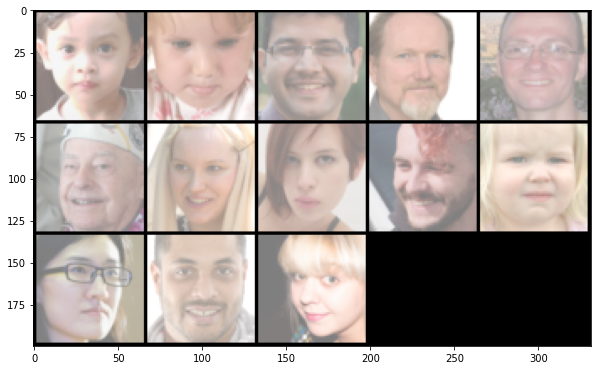

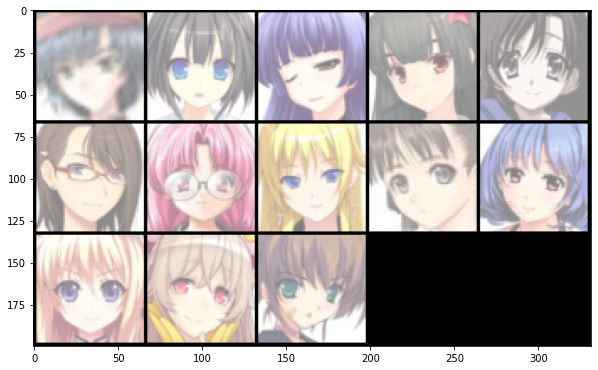

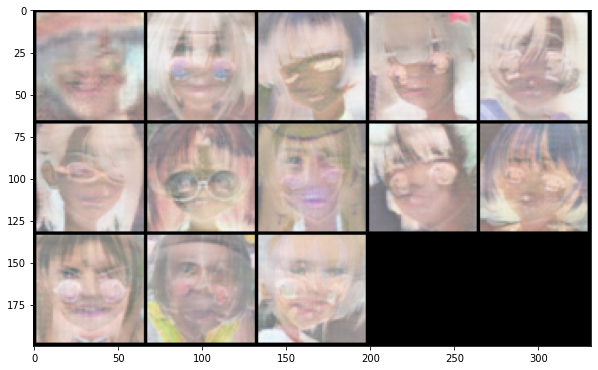

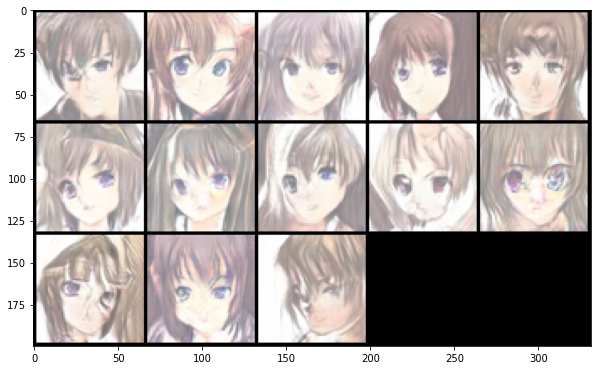

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 14: Generator (U-Net) loss: 464.83427143096924, Discriminator loss: 60.08055713400245


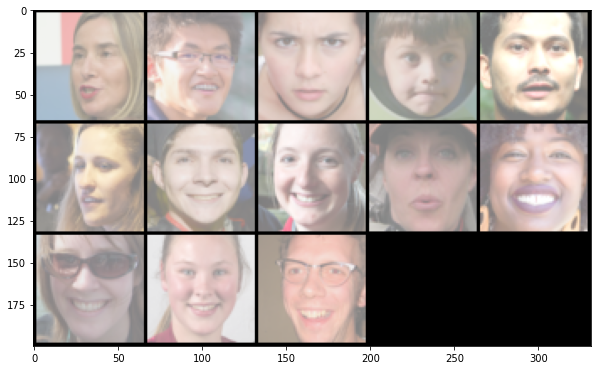

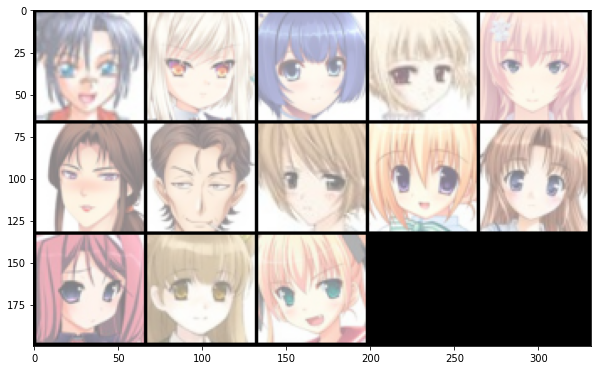

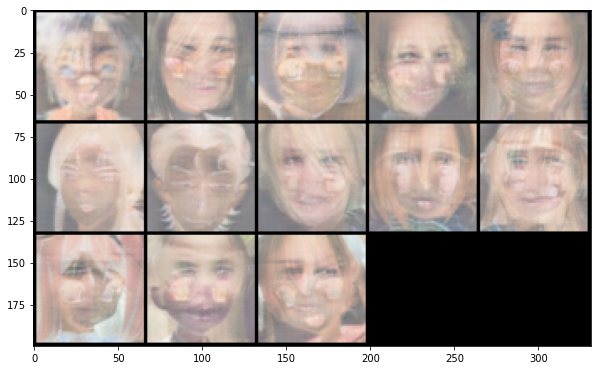

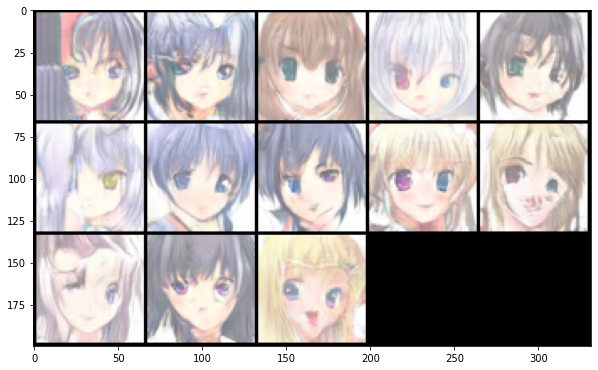

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 15: Generator (U-Net) loss: 499.9270103648305, Discriminator loss: 52.469482127577066


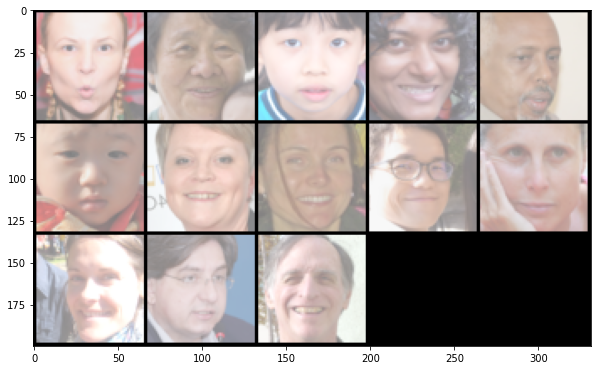

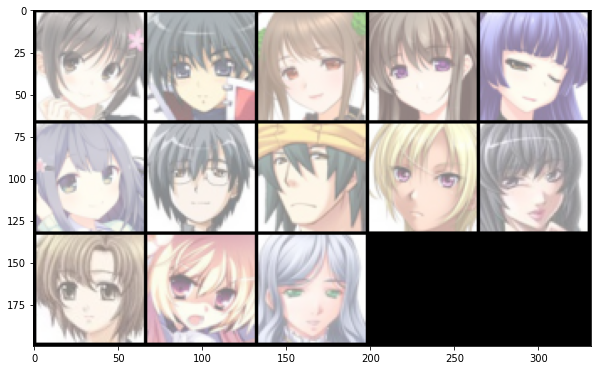

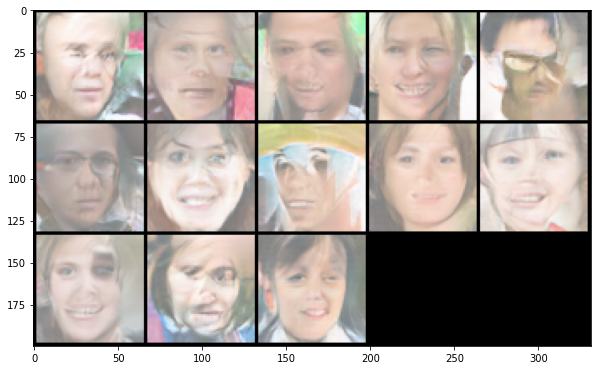

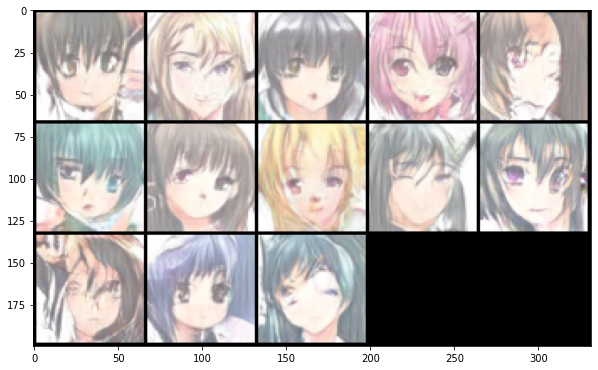

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 16: Generator (U-Net) loss: 446.63299135118723, Discriminator loss: 50.96533028502017


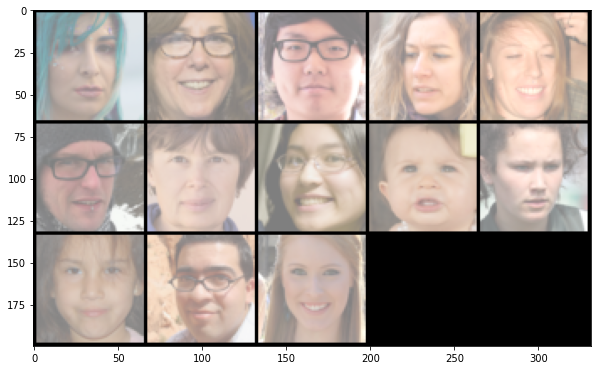

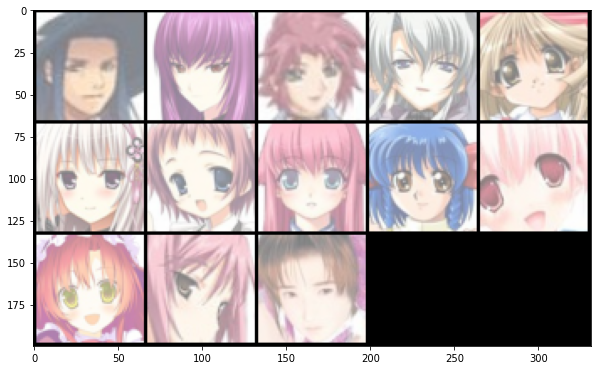

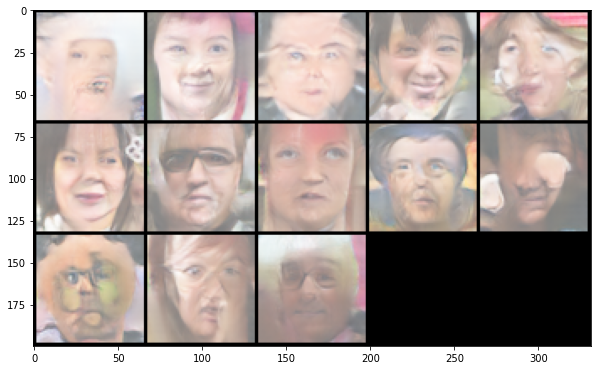

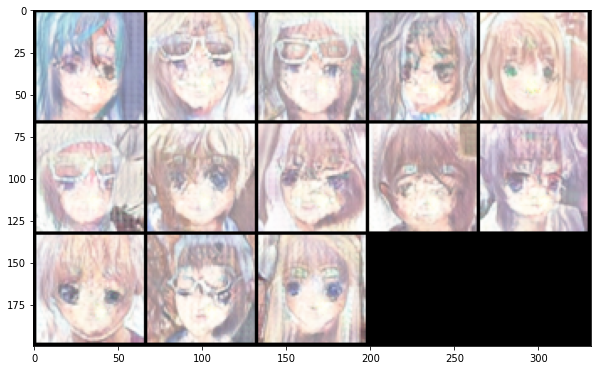

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 17: Generator (U-Net) loss: 419.1278485804796, Discriminator loss: 51.971168514341116


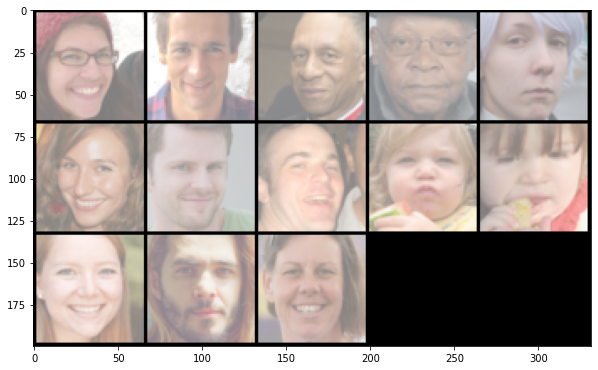

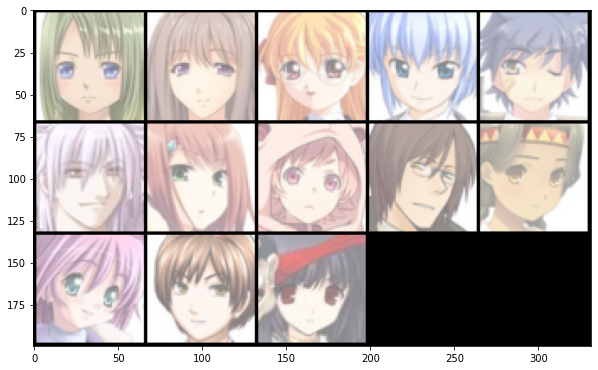

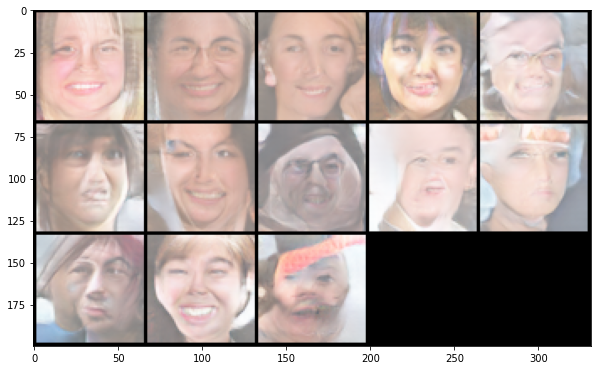

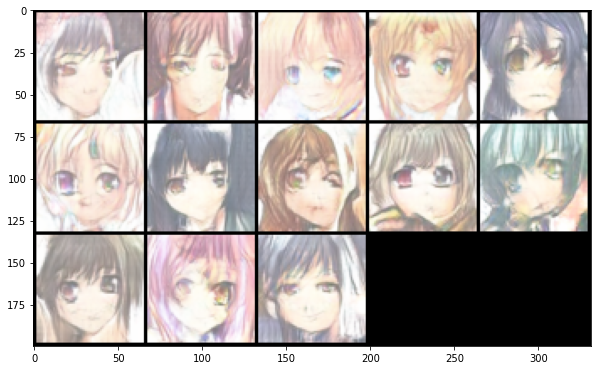

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 18: Generator (U-Net) loss: 478.3719813376665, Discriminator loss: 51.63807027414441


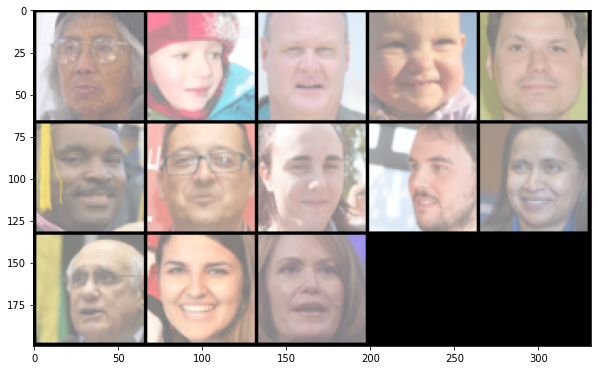

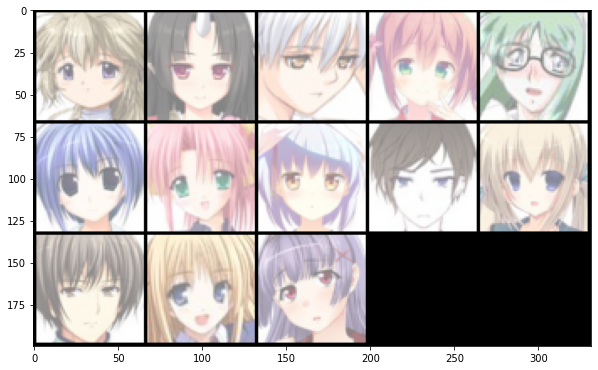

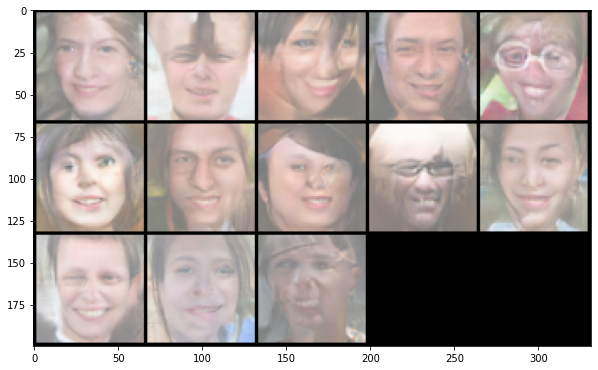

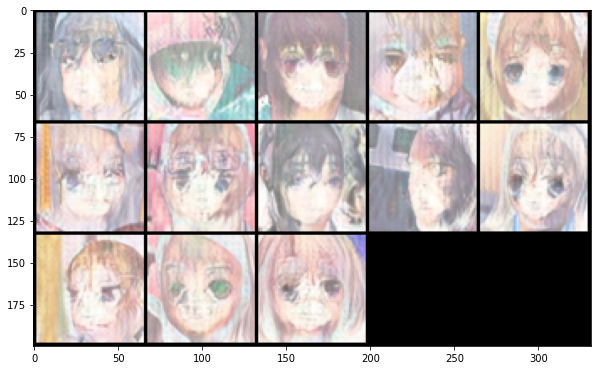

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 19: Generator (U-Net) loss: 364.82761131972075, Discriminator loss: 66.3515177052468


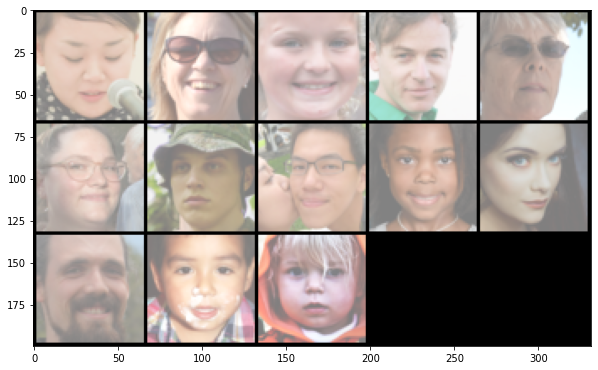

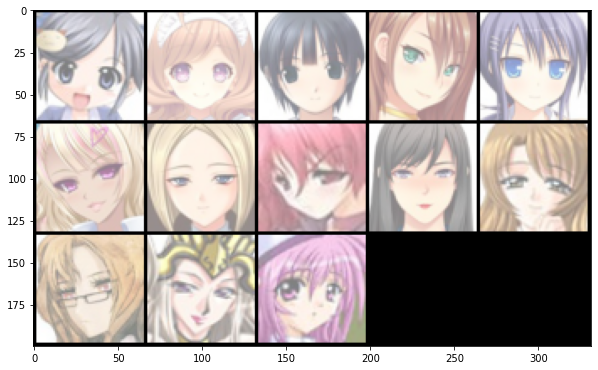

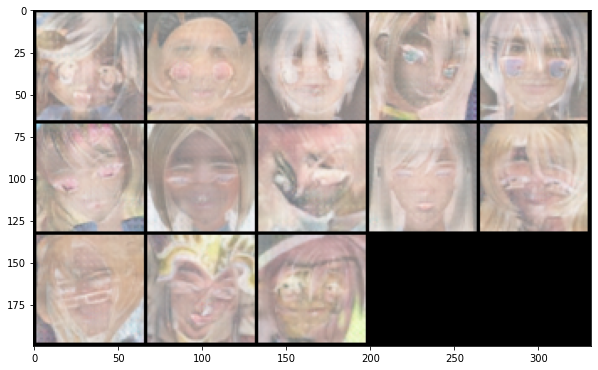

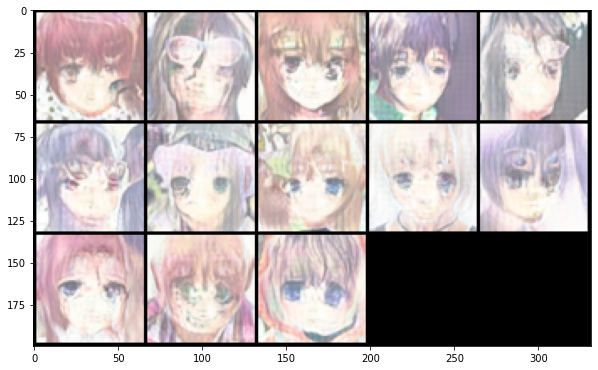

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 20: Generator (U-Net) loss: 414.9480619877577, Discriminator loss: 61.97082532569766


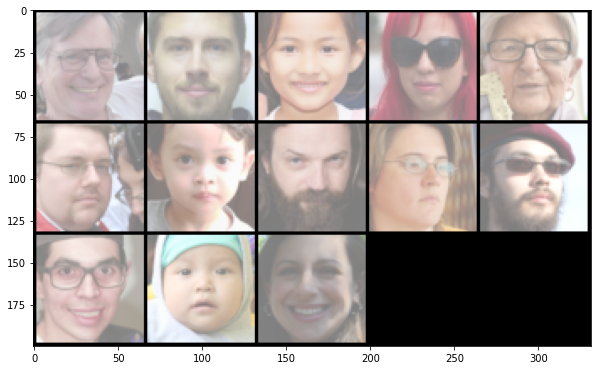

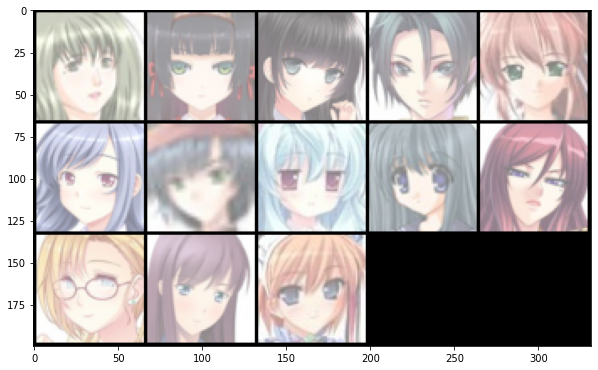

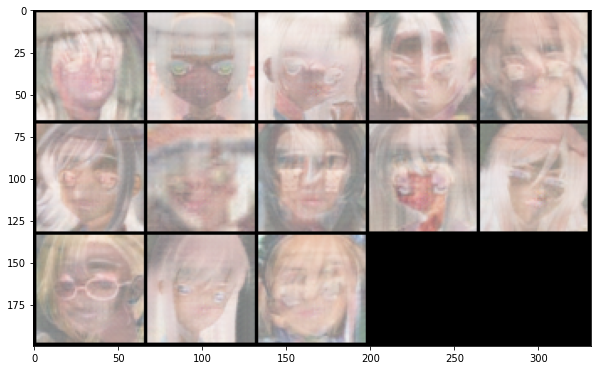

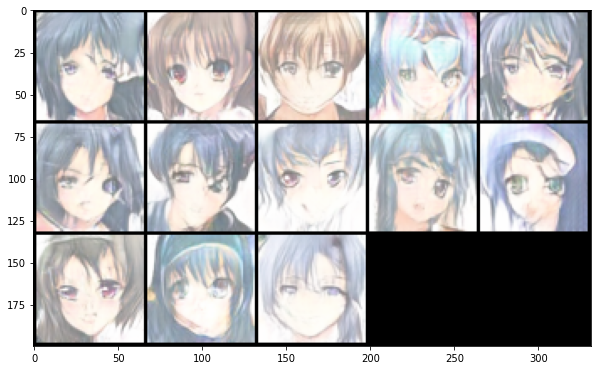

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 21: Generator (U-Net) loss: 436.33864233642817, Discriminator loss: 60.451060430146754


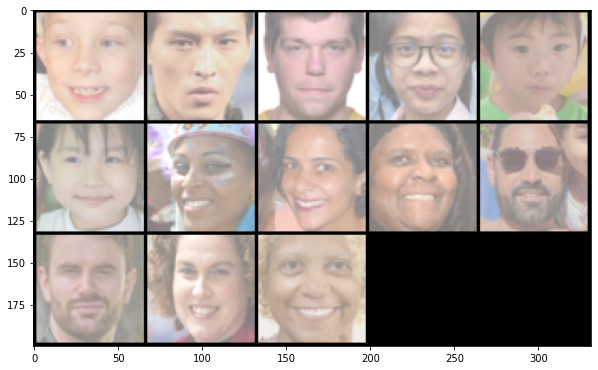

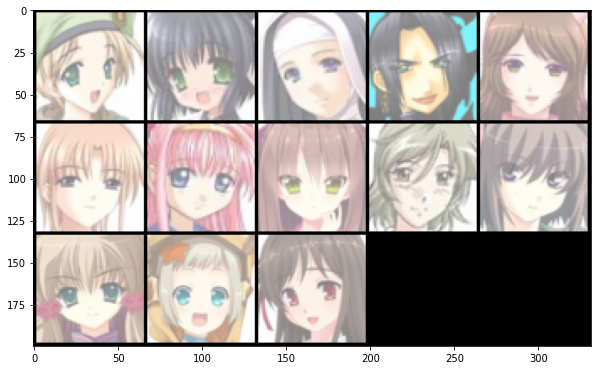

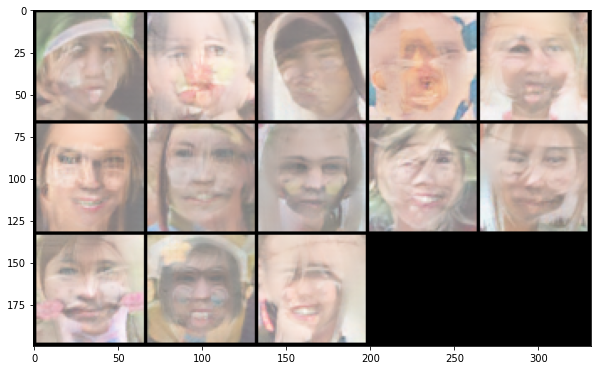

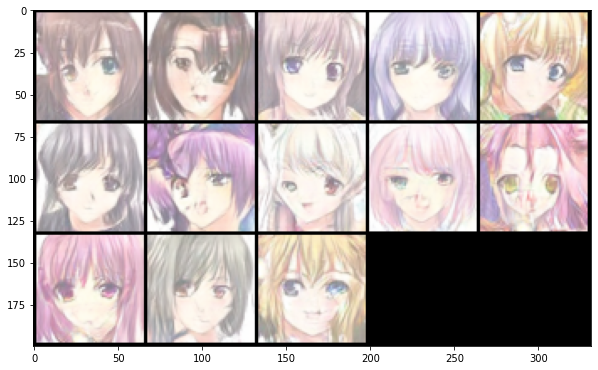

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 22: Generator (U-Net) loss: 456.9213188961148, Discriminator loss: 57.6382575398311


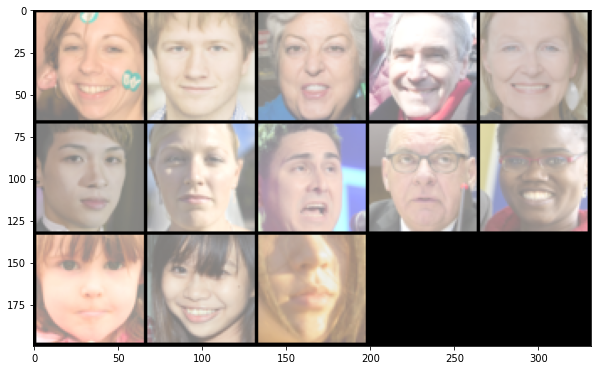

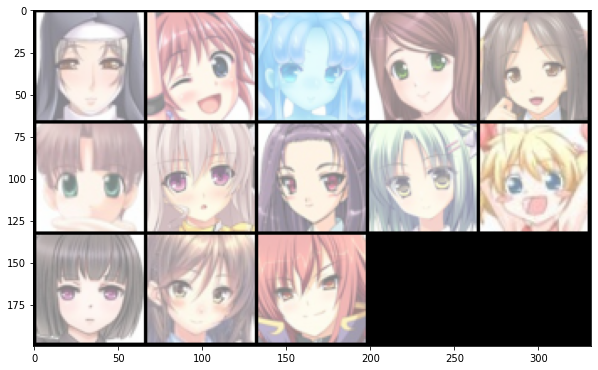

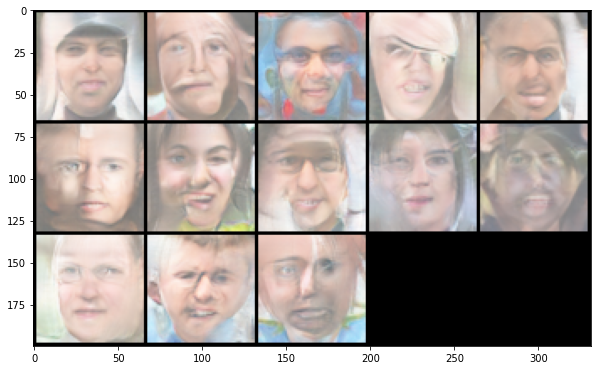

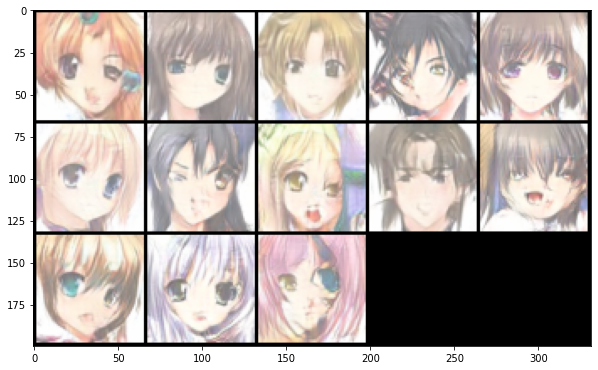

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 23: Generator (U-Net) loss: 475.4399446323514, Discriminator loss: 54.94666838366538


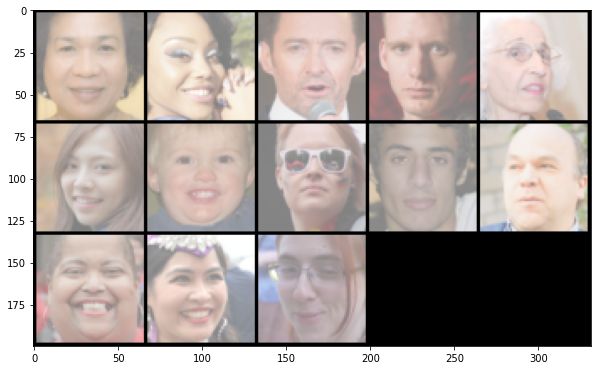

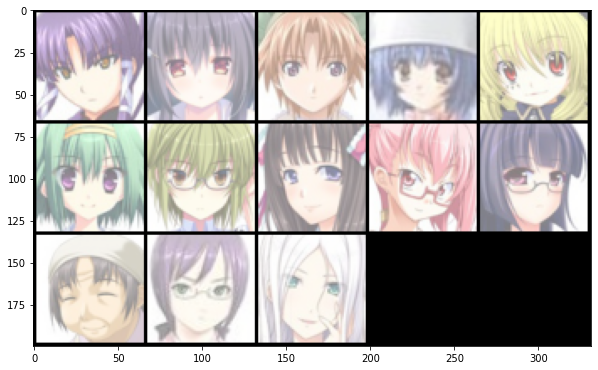

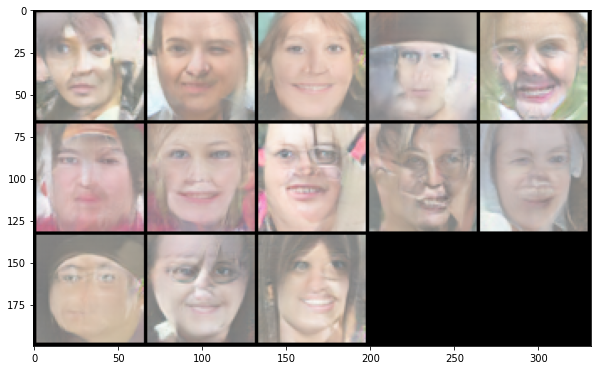

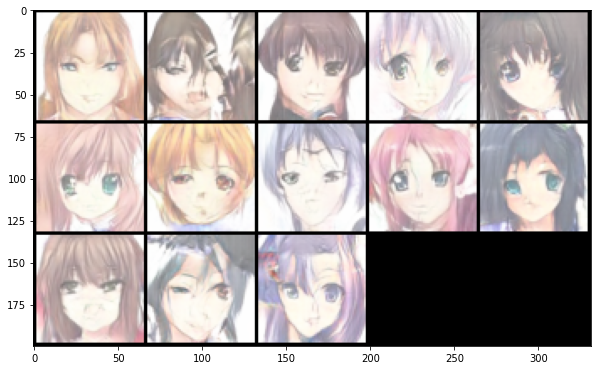

  0%|          | 0/3973 [00:00<?, ?it/s]

Epoch 24: Generator (U-Net) loss: 489.4092665910721, Discriminator loss: 53.05074810516089


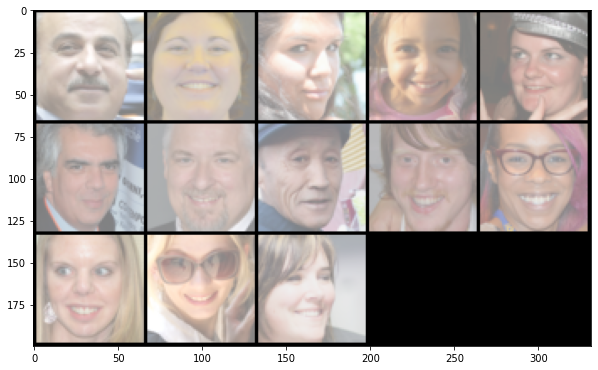

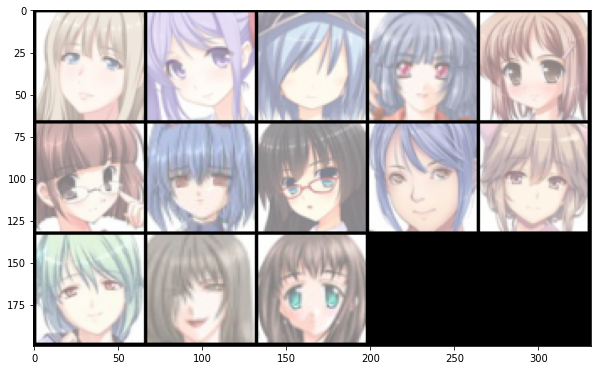

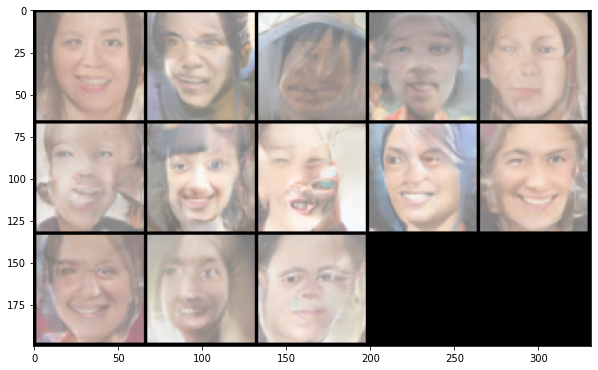

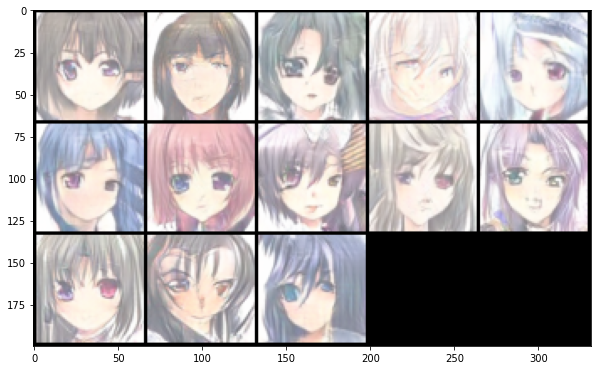

In [14]:
gen_loss, disc_loss = train()

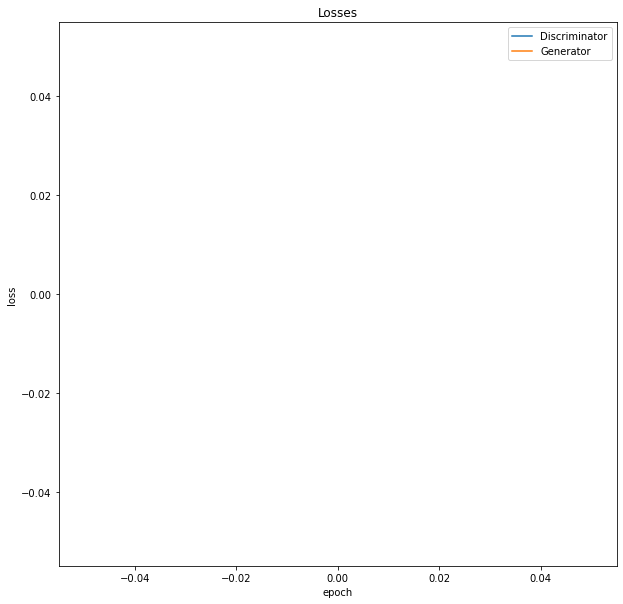

In [15]:
plt.plot(disc_loss, '-')
plt.plot(gen_loss, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses')
plt.show()

In [16]:
from torchvision.utils import save_image
sample_dir = 'laifu2waifu_64'
os.makedirs(sample_dir, exist_ok=True)

def save_samples(index, latent_tensors, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(fake_images, os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))
        
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)
save_samples(0, fixed_latent)


NameError: name 'latent_size' is not defined